In [1]:
"""from urllib.request import urlretrieve

filename_vlci = "vlci_vyskyt.zip"

url_vlci = "https://data.nature.cz/f02ffb21-8b57-41d6-9925-6cc5c209a494"

urlretrieve(url_vlci, filename_vlci)

file_vlci = f"/vsizip/{filename_vlci}" """



'from urllib.request import urlretrieve\n\nfilename_vlci = "vlci_vyskyt.zip"\n\nurl_vlci = "https://data.nature.cz/f02ffb21-8b57-41d6-9925-6cc5c209a494"\n\nurlretrieve(url_vlci, filename_vlci)\n\nfile_vlci = f"/vsizip/{filename_vlci}" '

In [2]:
import geopandas as gpd

Zipfile_vlci_path = "data/vlk_vyskyt.zip"
nested_file_vlci_path = "vlk_vyskyt.shp"

vlci_gdf = gpd.read_file(f"{Zipfile_vlci_path}!{nested_file_vlci_path}")

<Axes: >

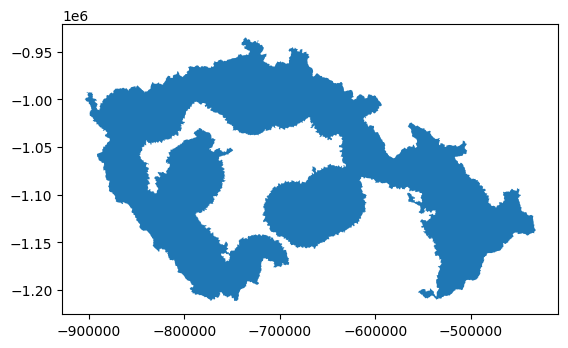

In [3]:
vlci_gdf.plot()

In [4]:
vlci_gdf.explore()

In [5]:
file_obce = "data/obce/obce.shp"
obce = gpd.read_file(file_obce)

In [6]:
file_poskozeni_vlci = "data/skody_od_vlku/skody_zpusobene_vlky.shp"
poskozeni_vlky = gpd.read_file(file_poskozeni_vlci)

<Axes: >

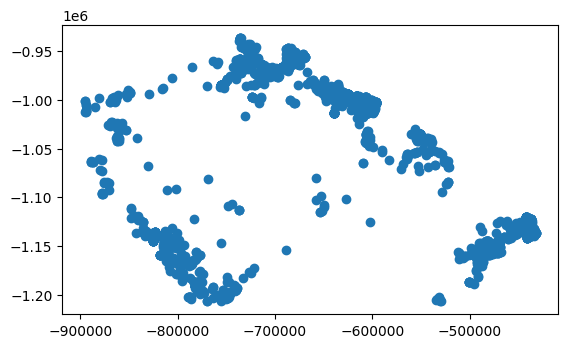

In [7]:
poskozeni_vlky.plot()

In [8]:
poskozeni_vlky.explore()

In [9]:
file_uhyn_vlku = "data/uhyn_vlku/uhyn_vlku.shp"
uhyn_vlku = gpd.read_file(file_uhyn_vlku)

In [10]:
uhyn_vlku.explore()

In [11]:
obce_s_vlky = obce.join(gpd.sjoin(poskozeni_vlky, obce).groupby("KOD_OBEC").size().rename("poskozeni_od_vlku"),
    on="KOD_OBEC",
    how="left"
)

In [14]:
obce_s_vlky = obce_s_vlky[obce_s_vlky["poskozeni_od_vlku"] > 0]

In [16]:
obce_s_vlky.explore(column='poskozeni_od_vlku', legend=True, cmap='OrRd')


In [ ]:
obce_s_vlky = obce_s_vlky.sort_values("poskozeni_vlky", ascending=False)

TypeError: DataFrame.sort_index() takes 1 positional argument but 2 were given